# Curate Plots

In [1]:
import numpy as np
import pandas as pd
import h5py
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator,LogLocator,NullFormatter)
from matplotlib.colors import LogNorm
import glob
import yaml
from astropy.cosmology import Planck15,z_at_value
from astropy import units as u
from scipy.interpolate import interp1d

In [3]:
import matplotlib
import matplotlib.pyplot as plt
matplotlib.rcParams['font.family'] = 'Times New Roman'
matplotlib.rcParams['font.sans-serif'] = ['Bitstream Vera Sans']
matplotlib.rcParams['text.usetex'] = True
matplotlib.rcParams['mathtext.fontset'] = 'cm'
matplotlib.rcParams['axes.unicode_minus'] = False

import seaborn as sns
sns.set_context('talk')
sns.set_style('ticks')
sns.set_palette('colorblind')
colors=sns.color_palette('colorblind')
fs=80

In [4]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF

In [5]:
import pymc as pm

WARN: Could not locate executable armflang


/cvmfs/software.igwn.org/conda/envs/igwn-py39-20240305/compiler_compat/ld: warning: libgfortran.so.5, needed by /usr/lib64/libopenblas.so, not found (try using -rpath or -rpath-link)
/cvmfs/software.igwn.org/conda/envs/igwn-py39-20240305/compiler_compat/ld: /usr/lib64/libopenblas.so: undefined reference to `expf@GLIBC_2.27'
/cvmfs/software.igwn.org/conda/envs/igwn-py39-20240305/compiler_compat/ld: /usr/lib64/libopenblas.so: undefined reference to `_gfortran_concat_string@GFORTRAN_8'
/cvmfs/software.igwn.org/conda/envs/igwn-py39-20240305/compiler_compat/ld: /usr/lib64/libopenblas.so: undefined reference to `powf@GLIBC_2.27'
/cvmfs/software.igwn.org/conda/envs/igwn-py39-20240305/compiler_compat/ld: /usr/lib64/libopenblas.so: undefined reference to `logf@GLIBC_2.27'
/cvmfs/software.igwn.org/conda/envs/igwn-py39-20240305/compiler_compat/ld: /usr/lib64/libopenblas.so: undefined reference to `_gfortran_etime@GFORTRAN_8'
collect2: error: ld returned 1 exit status


In [6]:
import arviz as az

In [7]:
from gwdistributions.distributions.spin.effective import IsotropicUniformMagnitudeChiEffGivenComponentMass

/home/anarya.ray/gppop-prod/spindev/gw-distributions/gwdistributions/transforms/location.py:10: UserWarning: Wswiglal-redir-stdio:

SWIGLAL standard output/error redirection is enabled in IPython.
This may lead to performance penalties. To disable locally, use:

with lal.no_swig_redirect_standard_output_error():
    ...

To disable globally, use:

lal.swig_redirect_standard_output_error(True)

Note however that this will likely lead to error messages from
LAL functions being either misdirected or lost when called from
Jupyter notebooks.

To suppress this warning, use:

import warnings
warnings.filterwarnings("ignore", "Wswiglal-redir-stdio")
import lal

  from lal.lal import GreenwichMeanSiderealTime as GMST


In [8]:
from gppop.core import Utils_spins,Utils,Vt_Utils_spins, Rates_spins, Post_Proc_Utils_spins

In [9]:
import os

## GWTC-3 prod results (Figure 1)

In [110]:
run_dir = 'test/gwtc3-clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new3.txt')
label = 'gwtc3'
trace = az.from_netcdf('test/gwtc3-clean/gppop_posterior_newbins3_kappa_corr.nc')

In [111]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

(8000, 660)

In [112]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [113]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [114]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [115]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [116]:
with h5py.File('../../gppop-mdc/3d-clean/GWTC-3-param-pm1m2z.h5','r') as f:
    print(list(f.keys()))
    ms = np.array(f['ms'])
    zs = np.array(f['zs'])
    Rz = np.array(f['pzs'])
    Rpm1_GWTC3 = np.array(f['pm1s'])
    Rpm2_GWTC3 = np.array(f['pm2s'])
pm1_GWTC3 = Rpm1_GWTC3/(np.trapz(Rpm1_GWTC3,ms,axis=1)[:,None])
pm2_GWTC3 = Rpm2_GWTC3/(np.trapz(Rpm2_GWTC3,ms,axis=1)[:,None])

['ms', 'pm1s', 'pm2s', 'pzs', 'zs']


In [117]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass1,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass1,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)

Rp_m1=np.array(pm1_GWTC3)#*ms)
Rp_m1/=np.trapz(Rp_m1,ms,axis=1).reshape((len(Rp_m1),1))
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)

ax.plot(np.linspace(ms[0],ms[-1],1000),np.interp(np.linspace(ms[0],ms[-1],1000),ms,Rpm_5),'--',color='black',label='Powerlaw+Peak ',alpha=0.6)
ax.plot(np.linspace(ms[0],ms[-1],1000),np.interp(np.linspace(ms[0],ms[-1],1000),ms,Rpm_95),'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')

ax.set_ylim(1e-8,1)
ax.set_xlim(6,100)
ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower center')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [118]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,dm1,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [119]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass2,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass2,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)
Rp_m1=np.array(pm2_GWTC3)#*ms)
Rp_m1/=np.trapz(Rp_m1,ms,axis=1).reshape((len(Rp_m1),1))
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)

ax.plot(np.linspace(ms[0],ms[-1],1000),np.interp(np.linspace(ms[0],ms[-1],1000),ms,Rpm_5),'--',color='black',label='Powerlaw+Peak ',alpha=0.6)
ax.plot(np.linspace(ms[0],ms[-1],1000),np.interp(np.linspace(ms[0],ms[-1],1000),ms,Rpm_95),'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')

ax.set_ylim(1e-8,1)
ax.set_xlim(6,100)
ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [120]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [121]:
import json
gwtc3_file='/home/daniel.wysocki/o3b-population-data/analyses/GaussianSpin/gaussian-spin-xeff-xp-ppd-data.json'
with open(gwtc3_file,'r') as jf:
    data = json.load(jf)
    print(list(data.keys()))

['chi_eff_grid', 'pop_samples', 'chi_p_grid', 'chi_eff_pdfs', 'chi_p_pdfs']


In [122]:
chi_gwtc3 = np.array(data['chi_eff_grid'])
Rp_chi_gwtc3 = np.array(data['chi_eff_pdfs'])
chi_gwtc3.shape,Rp_chi_gwtc3.shape

((2000,), (500, 2000))

In [123]:
np.arange(0,1000)[0:100:-1]

array([], dtype=int64)

In [124]:
from scipy.integrate import cumtrapz
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1 = np.concatenate((Rp_chi_1[:,0::100],Rp_chi_1[:,-1][:,None]),axis=1)
chi_sparse = chi[0::100]
chi_sparse = np.append(chi_sparse,chi[-1])
Rp_m1/= np.trapz(Rp_m1,chi_sparse,axis=1)[:,None]
RP_m1 = cumtrapz(Rp_m1,chi_sparse,axis=1,initial=0)
print(np.percentile(np.trapz(Rp_m1*chi_sparse,chi_sparse,axis=1),[0.05,0.5,0.95]))
Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)
chi_grid = np.linspace(chi[0],max(chi_sparse),50)
ax.fill_between(chi_grid,interp1d(chi_sparse,Rpm_5)(chi_grid),
                interp1d(chi_sparse,Rpm_95)(chi_grid),alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])
print(f'30-40, fraction<0:{interp1d(chi_sparse,Rpm_5)(0):0.2f},{interp1d(chi_sparse,R_pm_med)(0):0.2f},{interp1d(chi_sparse,Rpm_95)(0):0.2}')
#ax.plot(np.linspace(chi[0],max(chi[0::100]),50),interp1d(chi[0::100],R_pm_med)(np.linspace(chi[0],max(chi[0::100]),50)),color=colors[0],linewidth=4.0,label=r'$m\in(30,40)$')
Rp_m1 = np.concatenate((Rp_chi_2[:,0::100],Rp_chi_2[:,-1][:,None]),axis=1)
chi_sparse = chi[0::100]
chi_sparse = np.append(chi_sparse,chi[-1])
Rp_m1/= np.trapz(Rp_m1,chi_sparse,axis=1)[:,None]
RP_m1 = cumtrapz(Rp_m1,chi_sparse,axis=1,initial=0)
print(np.percentile(np.trapz(Rp_m1*chi_sparse,chi_sparse,axis=1),[0.05,0.5,0.95]))
Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)
chi_grid = np.linspace(chi[0],max(chi_sparse),50)
ax.fill_between(chi_grid,interp1d(chi_sparse,Rpm_5)(chi_grid),
                interp1d(chi_sparse,Rpm_95)(chi_grid),alpha=0.3,label=r'$m\notin(30,40)$',color=colors[1])
#ax.plot(np.linspace(chi[0],max(chi[0::100]),50),interp1d(chi[0::100],R_pm_med)(np.linspace(chi[0],max(chi[0::100]),50)),color=colors[1],linewidth=4.0,label=r'$m\notin(30,40)$')
#ax.set_yscale('log')


print(f'no 30-40, fraction<0:, {interp1d(chi_sparse,Rpm_5)(0):0.2f},{interp1d(chi_sparse,R_pm_med)(0):0.2f},{interp1d(chi_sparse,Rpm_95)(0):0.2}')
ax.scatter(0,0.5,marker='+',s=200,linewidths=8)

Rp_m1 = Rp_chi_gwtc3/np.trapz(Rp_chi_gwtc3,chi_gwtc3,axis=1)[:,None]
RP_m1 = cumtrapz(Rp_chi_gwtc3,chi_gwtc3,axis=1,initial=0)

Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)

ax.plot(chi_gwtc3,Rpm_5,'--',color='black',label='Gaussian model ',alpha=0.6)
ax.plot(chi_gwtc3,Rpm_95,'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')

#ax.set_xlim(-0.3,0.4)
ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$P(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.68, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'cdf_chi_eff_m_{label}.pdf')
fig.savefig(plot_dir+f'cdf_chi_eff_m_{label}.png')
#ax.set_ylim(1e-3,30)

[-0.34815905 -0.20808385 -0.12103228]
30-40, fraction<0:0.03,0.21,0.64
[-0.25409799 -0.0484189  -0.02462501]
no 30-40, fraction<0:, 0.03,0.10,0.32


In [125]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])

Rp_m1=Rp_chi_gwtc3
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
#ax.fill_between(chi_gwtc3,Rpm_5,Rpm_95,alpha=0.3,label=r'$Gaussian Model}$',color=colors[1])
ax.plot(chi_gwtc3,Rpm_5,'--',color='black',label='Gaussian model ',alpha=0.6)
ax.plot(chi_gwtc3,Rpm_95,'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')


ax.set_yscale('log')

ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [126]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

[0.949357170441881, 1.0]


In [127]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [128]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])

Rp_m1=Rp_chi_gwtc3
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
#ax.fill_between(chi_gwtc3,Rpm_5,Rpm_95,alpha=0.3,label=r'$Gaussian Model}$',color=colors[1])
ax.plot(chi_gwtc3,Rpm_5,'--',color='black',label='Gaussian model ',alpha=0.6)
ax.plot(chi_gwtc3,Rpm_95,'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')


ax.set_yscale('log')
ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

# Uncorrelated simulations (pop0)

In [129]:
run_dir = 'test/MDC_from_scratch/pop0a_clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir[:run_dir.index('pop0a')]+'mbins.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new17.txt')
label = 'pop0a'
trace = az.from_netcdf(run_dir+'gppop_posterior_pop0a_PhenomD_newbins17_kappa_corr.nc')

In [130]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

(12000, 594)

In [131]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [132]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [133]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [134]:
from gwpopulation.models import mass
M = np.linspace(6.01,70,100)
pm1 = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":M},
    alpha=4,
    mmin=6,
    delta_m=4,
    mpp=35,
    sigpp=4,
    mmax=70,
    lam=0.04)

In [135]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.15, 0.175)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.175, 0.2)
mass1,Rpm1_corr3 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.2, 0.225)

In [136]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.15,0.175) $',color=colors[0])

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.175,0.2)$')


Rp_m1=np.array(Rpm1_corr3)/np.trapz(Rpm1_corr3,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.2,0.225)$')
ax.plot(M,pm1,color='black',label='injected')
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
ax.set_ylim(1e-4,1e0)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.5, framealpha=0.,ncol=2,loc='upper center')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [137]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm1,d_chis,mbins,mbins,log_bin_centers,0.15, 0.175)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.175, 0.2)
mass2,Rpm2_corr3 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.2, 0.225)

In [138]:
M = np.linspace(6.01,70,100)
Q = np.linspace(0.,1.,100)
m1s,m2s = np.meshgrid(M,M)

pm1s = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=4,
    mmin=6,
    delta_m=4,
    mpp=35,
    sigpp=4,
    mmax=70,
    lam=0.04)
pqs = mass.SinglePeakSmoothedMassDistribution().p_q({"mass_1":m1s,"mass_ratio":m2s/m1s},beta=1.5,delta_m=4,mmin=6)

pm1m2s = pm1s*pqs/m1s
pm1m2s[m1s<m2s]=0.
pm1m2s/=np.trapz(np.trapz(pm1m2s,M,axis=0),M)

In [139]:
pm2=np.trapz(pm1m2s,M,axis=1)

In [140]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.15,0.175) $',color=colors[0])

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.175,0.2)$')


Rp_m1=np.array(Rpm2_corr3)/np.trapz(Rpm2_corr3,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.2,0.225)$')
ax.plot(M,pm2,color='black',label='injected')

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
ax.set_ylim(1e-4,1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [141]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [142]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])

ax.plot(chi,np.exp(-0.5*(chi-0.2)**2/(10.**(-1.8))**2)/np.sqrt(
    (2.*np.pi))/10.**(-1.8),color='black',label='injected')

ax.set_yscale('log')

ax.set_xlim(0,0.4)
ax.set_ylim(1e-2,50)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [143]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

[0.949357170441881, 1.0]


In [144]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [145]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])
ax.plot(chi,np.exp(-0.5*(chi-0.2)**2/(10.**(-1.8))**2)/np.sqrt(
    (2.*np.pi))/10.**(-1.8),color='black',label='injected')
ax.set_yscale('log')
ax.set_xlim(0.,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

### Correlated sims: pop1d

In [146]:

run_dir = 'test/MDC_from_scratch/pop1d_clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins6.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new3.txt')
print(chi_bins)
label = 'pop1d'
trace = az.from_netcdf(run_dir+'gppop_posterior_pop1d_PhenomD_newbins3mbins6_kappa_corr_trunc_snr11_combined.nc')

[-0.6  -0.4  -0.3  -0.2  -0.1  -0.05  0.    0.05  0.1   0.2   0.3   0.4
  0.6 ]


In [147]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

(8000, 936)

In [148]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [149]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [150]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [151]:
import bilby

M = np.linspace(6.01,70,500)
Q = np.linspace(0.,1.,500)
m1s,qs = np.meshgrid(M,Q)
#print(m1s[0,:5],qs[:5,0])
pm1s = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=4,
    mmin=6,
    delta_m=4,
    mpp=35,
    sigpp=4,
    mmax=70,
    lam=0.04)
pqs = np.array([bilby.core.prior.analytical.PowerLaw(alpha=1.5, minimum=6/m, maximum=1).prob(Q)/np.trapz(bilby.core.prior.analytical.PowerLaw(alpha=1.5, minimum=6/m, maximum=1).prob(Q),Q) for m in M]).T
#mass.SinglePeakSmoothedMassDistribution().p_q({"mass_1":m1s,"mass_ratio":qs},beta=1.5,delta_m=4,mmin=6)

pm1qs=pm1s*pqs
pm1qs/=np.trapz(np.trapz(pm1qs,M,axis=1),Q)
qs[0,:5],m1s[:5,0]


(array([0., 0., 0., 0., 0.]), array([6.01, 6.01, 6.01, 6.01, 6.01]))

In [153]:
from scipy.interpolate import interp1d
chi_grid =np.linspace(-1,1,200)
Q_grid = np.linspace(0.,1,200)
p_chiq = np.exp(
    -0.5*(chi_grid[:,None]-(
        -0.0185-0.4*(Q_grid[None,:]-1)))**2/(10.**(-1.33-0.14*(Q_grid[None,:]-1)))**2)/np.sqrt(
    (2.*np.pi))/10.**(-1.33-0.14*(Q_grid[None,:]-1))
p_chiq_norm=np.trapz(p_chiq,chi_grid,axis=0)
print(p_chiq.shape,p_chiq_norm.shape)
def p_chi_lims(chi_min,chi_max,qs):
    p_chiq_copy = p_chiq.copy()
    p_chiq_copy[np.where((chi_grid>=chi_min)*(chi_grid<=chi_max))[0],:] = 0.
    return interp1d(Q_grid,
                     np.trapz(p_chiq_copy,chi_grid,axis=0)/np.trapz(p_chiq,chi_grid,axis=0))(qs)
def p_chi_center(chi_c,qs):
    return interp1d(Q_grid,np.exp(
    -0.5*(chi_c-(
        -0.0185-0.4*(Q_grid-1)))**2/(10.**(-1.33-0.14*(Q_grid-1)))**2)/np.sqrt(
    (2.*np.pi))/10.**(-1.33-0.14*(Q_grid-1))/p_chiq_norm)(qs)

(200, 200) (200,)


In [154]:
print(0.5*(chi_bins[1:]+chi_bins[:-1]),chi_bins)

[-0.5   -0.35  -0.25  -0.15  -0.075 -0.025  0.025  0.075  0.15   0.25
  0.35   0.5  ] [-0.6  -0.4  -0.3  -0.2  -0.1  -0.05  0.    0.05  0.1   0.2   0.3   0.4
  0.6 ]


In [155]:

chi_lo1,chi_lo2,chi_lo3 = -0.05,   0.0, 0.05
chi_u1,chi_u2,chi_u3 =  0.0, 0.05, 0.1
chi_cs = [-0.025,0.025,0.075]

In [156]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo1,chi_u1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo2, chi_u2)
mass1,Rpm1_corr3 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo3, chi_u3)


In [157]:
pm11 = np.trapz(p_chi_center(chi_cs[0],qs)*pm1qs,Q,axis=0)
pm11/=np.trapz(pm11,M)
pm12 = np.trapz(p_chi_center(chi_cs[1],qs)*pm1qs,Q,axis=0)
pm12/=np.trapz(pm12,M)
pm13 = np.trapz(p_chi_center(chi_cs[2],qs)*pm1qs,Q,axis=0)
pm13/=np.trapz(pm13,M)

In [158]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0,0.1) $',color=colors[0])
ax.plot(M,pm11,color=colors[0],label='injected')

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.15)$')
ax.plot(M,pm12,color=colors[1])

Rp_m1=np.array(Rpm1_corr3)/np.trapz(Rpm1_corr3,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')
ax.plot(M,pm13,color=colors[2])

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
ax.set_ylim(1e-4,1e0)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.5, framealpha=0.,ncol=3,loc='upper center')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [159]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm1,d_chis,mbins,mbins,log_bin_centers,chi_lo1,chi_u1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo2,chi_u2)
mass2,Rpm2_corr3 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo3,chi_u3)

In [160]:
M = np.linspace(6.01,70,500)
Q = np.linspace(0.,1.,100)
m1s,m2s = np.meshgrid(M,M)

pm1s = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=4,
    mmin=6,
    delta_m=4,
    mpp=35,
    sigpp=4,
    mmax=70,
    lam=0.04)
pqs = pqs = np.array([bilby.core.prior.analytical.PowerLaw(alpha=1.5, minimum=6/m, maximum=1).prob(M/m) for m in M]).T

#mass.SinglePeakSmoothedMassDistribution().p_q({"mass_1":m1s,"mass_ratio":m2s/m1s},beta=1.5,delta_m=4,mmin=6)

pm1m2s = pm1s*pqs/m1s
pm1m2s[m1s<m2s]=0.
pm1m2s/=np.trapz(np.trapz(pm1m2s,M,axis=0),M)

In [161]:
qs.shape

(500, 500)

In [162]:
p_chi_int = np.zeros_like(m1s)
p_chi_int[m2s<=m1s] = p_chi_center(chi_cs[0],(m2s/m1s)[m2s<=m1s])
pm21=np.trapz(pm1m2s*p_chi_int,M,axis=1)
pm21/=np.trapz(pm21,M)
p_chi_int = np.zeros_like(m1s)
p_chi_int[m2s<=m1s] = p_chi_center(chi_cs[1],(m2s/m1s)[m2s<=m1s])
pm22=np.trapz(pm1m2s*p_chi_int,M,axis=1)
pm22/=np.trapz(pm22,M)
p_chi_int = np.zeros_like(m1s)
p_chi_int[m2s<=m1s] = p_chi_center(chi_cs[2],(m2s/m1s)[m2s<=m1s])
pm23=np.trapz(pm1m2s*p_chi_int,M,axis=1)
pm23/=np.trapz(pm23,M)

In [163]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0,0.1) $',color=colors[0])
ax.plot(M,pm21,color=colors[0],label='injected')

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.15)$')
ax.plot(M,pm22,color=colors[1])

Rp_m1=np.array(Rpm2_corr3)/np.trapz(Rpm2_corr3,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')
ax.plot(M,pm23,color=colors[2])

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
ax.set_ylim(1e-4,1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [164]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [165]:
pm1m2s_3040 = pm1m2s.copy()
arg = (m1s<40)&(m2s<m1s)&(m2s>30)
pm1m2s_3040[~arg] = 0. 
pm1m2s_no3040 = pm1m2s.copy()
#arg = (m1s<40)&(m2s<m1s)&(m2s>30)
pm1m2s_no3040[arg] = 0. 
p_chi_int = np.zeros_like(m1s)
p_chi_3040 = np.array([])
p_chi_no3040 = np.array([])
for this_chi in chi_grid:
    p_chi_int[m2s<=m1s] = p_chi_center(this_chi,(m2s/m1s)[m2s<=m1s])
    p_chi_3040 = np.append(p_chi_3040,np.trapz(np.trapz(p_chi_int*pm1m2s_3040,M,axis=0),M))
    p_chi_no3040 = np.append(p_chi_no3040,np.trapz(np.trapz(p_chi_int*pm1m2s_no3040,M,axis=0),M))

In [166]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])
ax.plot(chi_grid,p_chi_3040/np.trapz(p_chi_3040,chi_grid),color=colors[0],label='injected')

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
ax.plot(chi_grid,p_chi_no3040/np.trapz(p_chi_no3040,chi_grid),color=colors[1])#,label='injected')

#ax.plot(chi,p_chi,color='black',label='injected')

ax.set_yscale('log')

ax.set_xlim(-0.4,0.8)
ax.set_ylim(1e-2,50)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=3,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


## Correlated sims pop2b

In [167]:
run_dir = 'test/MDC_from_scratch/pop2b_clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir[:run_dir.index('pop2b')]+'mbins.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new29.txt')
label = 'pop2b'
trace = az.from_netcdf(run_dir+'gppop_posterior_pop2b_PhenomD_newbins29_kappa_corr_multimu_trunc.nc')

In [168]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

(30000, 594)

In [169]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [170]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [171]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [172]:
from gwpopulation.models import mass
M = np.linspace(6.01,70,100)
pm1 = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":M},
    alpha=4,
    mmin=6,
    delta_m=4,
    mpp=35,
    sigpp=4,
    mmax=70,
    lam=0.04)

In [173]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.0, 0.1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.1, 0.15)
mass1,Rpm1_corr3 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.15, 0.25)
mass1,Rpm1_corr4 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.25,0.35)


In [174]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0,0.1) $',color=colors[0])

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.15)$')


Rp_m1=np.array(Rpm1_corr3)/np.trapz(Rpm1_corr3,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')

Rp_m1=np.array(Rpm1_corr4)/np.trapz(Rpm1_corr4,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[3],label=r'$\chi_{eff} \in (0.25,0.35)$')
ax.plot(M,pm1,color='black',label='injected')
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
ax.set_ylim(1e-4,1e0)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.5, framealpha=0.,ncol=3,loc='upper center')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [175]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm1,d_chis,mbins,mbins,log_bin_centers,0, 0.1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.1, 0.15)
mass2,Rpm2_corr3 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.15, 0.25)
mass2,Rpm2_corr4 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,0.25, 0.35)

In [176]:
M = np.linspace(6.01,70,100)
Q = np.linspace(0.,1.,100)
m1s,m2s = np.meshgrid(M,M)

pm1s = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=4,
    mmin=6,
    delta_m=4,
    mpp=35,
    sigpp=4,
    mmax=70,
    lam=0.04)
pqs = mass.SinglePeakSmoothedMassDistribution().p_q({"mass_1":m1s,"mass_ratio":m2s/m1s},beta=1.5,delta_m=4,mmin=6)

pm1m2s = pm1s*pqs/m1s
pm1m2s[m1s<m2s]=0.
pm1m2s/=np.trapz(np.trapz(pm1m2s,M,axis=0),M)

In [177]:
pm2=np.trapz(pm1m2s,M,axis=1)

In [178]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0,0.1) $',color=colors[0])

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.15)$')


Rp_m1=np.array(Rpm2_corr3)/np.trapz(Rpm2_corr3,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')

Rp_m1=np.array(Rpm2_corr4)/np.trapz(Rpm2_corr4,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[3],label=r'$\chi_{eff} \in (0.25,0.35)$')


ax.plot(M,pm2,color='black',label='injected')

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
ax.set_ylim(1e-4,1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [179]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [180]:
from astropy.cosmology import Planck15
zs = np.linspace(0.0001,1,1000)[None,:]
sigma_chi = 10.**(-0.85+0.88*(zs-0.5))
p_chi_given_z = (np.exp(
    -0.5*(chi[:,None]-0.2)**2/(sigma_chi**2))/np.sqrt(
    (2.*np.pi))/sigma_chi)*4.0*np.pi*(1+zs)**(
    3-1)*Planck15.differential_comoving_volume(zs).to(u.Gpc**3/u.sr).value

p_chi = np.trapz(p_chi_given_z,zs,axis=1)/np.trapz(np.trapz(p_chi_given_z,zs,axis=1),chi)

In [181]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])

ax.plot(chi,p_chi,color='black',label='injected')

ax.set_yscale('log')

ax.set_xlim(-0.4,0.8)
ax.set_ylim(1e-2,50)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [182]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

[0.949357170441881, 1.0]


In [183]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [184]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])
ax.plot(chi,p_chi,color='black',label='injected')
ax.set_yscale('log')
ax.set_xlim(-0.4,0.8)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

### Correlated sims pop3a

In [292]:

run_dir = 'test/MDC_from_scratch/pop3a_clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins2.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new8.txt')
print(chi_bins)
label = 'pop3a'
trace = az.from_netcdf(run_dir+'gppop_posterior_pop3a_PhenomD_newbins8_mbins2_corr.nc')

[-0.6  -0.3  -0.2  -0.1   0.    0.05  0.1   0.25  0.4   0.45  0.55  0.6
  0.7   0.8   1.  ]


In [293]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

(18000, 630)

In [294]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [295]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [296]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [297]:
import json
with open("/home/anarya.ray/gppop-prod/MDC_from_scratch/pop3a.json",'r') as jf:
    underlying_pop = json.load(jf)
print(underlying_pop)

{'mmin': 8, 'alpha1': 3, 'alpha2': 0.5, 'beta_q': 1.5, 'mmax': 70, 'lam1': 0, 'lam2': 0.3, 'mpp': 35, 'sigpp': 3, 'delta_m': 10.0, 'lamb': 3, 'mu_chi1': 0.15, 'mu_chi2': 0.5, 'log10_sigma_chi1': -1.1, 'log10_sigma_chi2': -0.8, 'zmax': 1.0, 'f': 0.6}


In [298]:
from gwpopulation.models import mass
import bilby
M = np.linspace(underlying_pop["mmin"]+0.01,80,100)
# Q = np.linspace(0.125,1.,100)
# m1s,qs = np.meshgrid(M,Q)

m1s,m2s = np.meshgrid(M,M)

pm1s_1 = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=underlying_pop["alpha1"],
    mmin=underlying_pop["mmin"],
    delta_m=underlying_pop["delta_m"],
    mpp=underlying_pop["mpp"],
    sigpp=underlying_pop["sigpp"],
    mmax=underlying_pop["mmax"],
    lam=underlying_pop["lam1"])

pm1s_2 = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=underlying_pop["alpha2"],
    mmin=underlying_pop["mmin"],
    delta_m=underlying_pop["delta_m"],
    mpp=underlying_pop["mpp"],
    sigpp=underlying_pop["sigpp"],
    mmax=underlying_pop["mmax"],
    lam=underlying_pop["lam2"])

                         
# pqs  = np.array([bilby.core.prior.analytical.PowerLaw(alpha=underlying_pop["beta_q"], 
#                                                            minimum=underlying_pop["mmin"]/m,
#                                                            maximum=1).prob(M/m) for m in M]).T
pqs = mass.SinglePeakSmoothedMassDistribution().p_q({"mass_1":m1s,"mass_ratio":m2s/m1s},
                                                    beta=underlying_pop["beta_q"],
                                                    delta_m=underlying_pop["delta_m"],
                                                    mmin=underlying_pop["mmin"])

pm1m2s_1 = pm1s_1*pqs/m1s
pm1m2s_1[m1s<m2s]=0.
pm1m2s_1/=np.trapz(np.trapz(pm1m2s_1,M,axis=1),M)
pm1m2s_2 = pm1s_2*pqs/m1s
pm1m2s_2[m1s<m2s]=0.
pm1m2s_2/=np.trapz(np.trapz(pm1m2s_2,M,axis=1),M)

In [299]:
chi_grid = np.linspace(-1,1,500)
p_chi_1 = (np.exp(-0.5*(chi_grid-
                       underlying_pop["mu_chi1"])**2/
                 (10.**underlying_pop["log10_sigma_chi1"])**2)/np.sqrt(2.*np.pi)/
           10.**underlying_pop["log10_sigma_chi1"])

p_chi_2 = (np.exp(-0.5*(chi_grid-
                       underlying_pop["mu_chi2"])**2/
                 (10.**underlying_pop["log10_sigma_chi2"])**2)/np.sqrt(2.*np.pi)/
           10.**underlying_pop["log10_sigma_chi2"])



p_chi_1/=np.trapz(p_chi_1,chi_grid)
p_chi_2/=np.trapz(p_chi_2,chi_grid)

                


In [300]:

chi_lo1,chi_lo2 = 0.1,0.4   
chi_u1,chi_u2 = 0.25, 0.6
#chi_cs = [-0.025,0.025,0.075]

In [301]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo1,chi_u1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo2, chi_u2)
# mass1,Rpm1_corr3 = pp_utils.get_Rpm1_corr(n_corr_samples,
#                                           dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo3, chi_u3)


In [302]:
arg = (chi_grid<chi_u1)&(chi_grid>chi_lo1)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm11 = (np.trapz(this_pchi_1,chi_grid)*pm1s_1[0,:]/np.trapz(pm1s_1[0,:],M)*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm1s_2[0,:]/np.trapz(pm1s_2[0,:],M)*(1-
                                                                    underlying_pop["f"]))
        
pm11/=np.trapz(pm11,M)

arg = (chi_grid<chi_u2)&(chi_grid>chi_lo2)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm12 = (np.trapz(this_pchi_1,chi_grid)*pm1s_1[0,:]/np.trapz(pm1s_1[0,:],M)*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm1s_2[0,:]/np.trapz(pm1s_2[0,:],M)*(1-
                                                                    underlying_pop["f"]))
        
pm12/=np.trapz(pm12,M)
# pm12 = np.trapz(p_chi_center(chi_cs[1],qs)*pm1qs,Q,axis=0)
# pm12/=np.trapz(pm12,M)
# pm13 = np.trapz(p_chi_center(chi_cs[2],qs)*pm1qs,Q,axis=0)
# pm13/=np.trapz(pm13,M)

In [303]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.1,0.25) $',color=colors[0])
ax.plot(M,pm11,color=colors[0],label='injected')

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.4,0.6)$')
ax.plot(M,pm12,color=colors[1])

# Rp_m1=np.array(Rpm1_corr3)/np.trapz(Rpm1_corr3,mass1,axis=1)[:,None]
# Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
# Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
# R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
# ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')
# ax.plot(M,pm13,color=colors[2])

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(8,72)
ax.set_ylim(1e-4,1e0)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.6))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.6))
ax.legend(fontsize=fs*0.5, framealpha=0.,ncol=3,loc='upper center')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [304]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm1,d_chis,mbins,mbins,log_bin_centers,chi_lo1,chi_u1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo2,chi_u2)
# mass2,Rpm2_corr3 = pp_utils.get_Rpm2_corr(n_corr_samples,
#                                           dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo3,chi_u3)

In [305]:
pm2s_1 = np.trapz(pm1m2s_1,M,axis=1)
pm2s_2 = np.trapz(pm1m2s_2,M,axis=1)

arg = (chi_grid<chi_u1)&(chi_grid>chi_lo1)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm21 = (np.trapz(this_pchi_1,chi_grid)*pm2s_1*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm2s_2*(1-underlying_pop["f"]))
        
pm21/=np.trapz(pm21,M)

arg = (chi_grid<chi_u2)&(chi_grid>chi_lo2)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm22 = (np.trapz(this_pchi_1,chi_grid)*pm2s_1*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm2s_2*(1-
                                                                    underlying_pop["f"]))
pm22/=np.trapz(pm22,M)

In [306]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0,0.1) $',color=colors[0])
ax.plot(M,pm21,color=colors[0],label='injected')

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.15)$')
ax.plot(M,pm22,color=colors[1])



ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(8,72)
ax.set_ylim(1e-4,1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.6))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.6))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [307]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [308]:
pm1m2s_1_3040 = pm1m2s_1.copy()
pm1m2s_2_3040 = pm1m2s_2.copy()
arg = (m1s<40)&(m2s<m1s)&(m2s>30)
pm1m2s_1_3040[~arg] = 0. 
pm1m2s_2_3040[~arg] = 0. 

p_chi_given_m_1 = (np.trapz(
    np.trapz(pm1m2s_1_3040,M,axis=1),M)*p_chi_1*underlying_pop["f"] + 
                   np.trapz(
    np.trapz(pm1m2s_2_3040,M,axis=1),M)*p_chi_2*(1-underlying_pop["f"]))

pm1m2s_1_3040 = pm1m2s_1.copy()
pm1m2s_2_3040 = pm1m2s_2.copy()
arg = (m1s<40)&(m2s<m1s)&(m2s>30)
pm1m2s_1_3040[arg] = 0. 
pm1m2s_2_3040[arg] = 0. 

p_chi_given_m_2 = (np.trapz(
    np.trapz(pm1m2s_1_3040,M,axis=1),M)*p_chi_1*underlying_pop["f"] + 
                   np.trapz(
    np.trapz(pm1m2s_2_3040,M,axis=1),M)*p_chi_2*(1-underlying_pop["f"]))

In [309]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])
#ax.plot(chi_grid,p_chi_3040/np.trapz(p_chi_3040,chi_grid),color=colors[0],label='injected')

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
#ax.plot(chi_grid,p_chi_no3040/np.trapz(p_chi_no3040,chi_grid),color=colors[1])#,label='injected')
ax.plot(chi_grid,p_chi_given_m_1/np.trapz(p_chi_given_m_1,chi_grid),color=colors[0],label='injected')
ax.plot(chi_grid,p_chi_given_m_2/np.trapz(p_chi_given_m_2,chi_grid),color=colors[1])
#ax.plot(chi,p_chi,color='black',label='injected')

ax.set_yscale('log')

ax.set_xlim(-0.125,1.)
ax.set_ylim(1e-2,50)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=3,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [310]:
print(p_chi_given_m_1.shape,chi_grid.shape)
# cumtrapz(p_chi_given_m_1,chi_grid,initial=0)
chi_grid_copy = chi_grid.copy()

(500,) (500,)


In [311]:
print(chi[0::100]),chi[-1]

[-0.6  -0.3  -0.2  -0.1   0.    0.05  0.1   0.25  0.4   0.45  0.55  0.6
  0.7   0.8 ]


(None, 1.0)

In [312]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [313]:
from scipy.integrate import cumtrapz
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1 = np.concatenate((Rp_chi_1[:,0::100],Rp_chi_1[:,-1][:,None]),axis=1)
chi_copy = np.append(chi[0::100],chi[-1])
Rp_m1/=np.trapz(Rp_m1,chi_copy,axis=1)[:,None]
#/np.trapz(Rp_chi_1[:,0::100],chi[0::100],axis=1)[:,None]
RP_m1 = cumtrapz(Rp_m1,chi_copy,axis=1,initial=0)

Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)
chi_grid = np.linspace(chi[0],max(chi_copy),50)
ax.fill_between(chi_grid,interp1d(chi_copy,Rpm_5)(chi_grid),
                interp1d(chi_copy,Rpm_95)(chi_grid),alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])
#print('30-40, fraction<0:', interp1d(chi[0::100],Rpm_5)(0),interp1d(chi[0::100],R_pm_med)(0),interp1d(chi[0::100],Rpm_95)(0))
#ax.plot(np.linspace(chi[0],max(chi[0::100]),50),interp1d(chi[0::100],R_pm_med)(np.linspace(chi[0],max(chi[0::100]),50)),color=colors[0],linewidth=4.0,label=r'$m\in(30,40)$')
Rp_m1 = np.concatenate((Rp_chi_2[:,0::100],Rp_chi_2[:,-1][:,None]),axis=1)
chi_grid = np.linspace(chi[0],max(chi_copy),50)
Rp_m1/=np.trapz(Rp_m1,chi_copy,axis=1)[:,None]
#/np.trapz(Rp_chi_1[:,0::100],chi[0::100],axis=1)[:,None]
RP_m1 = cumtrapz(Rp_m1,chi_copy,axis=1,initial=0)

Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)
chi_grid = np.linspace(chi[0],max(chi[0::100]),50)
ax.fill_between(chi_grid,interp1d(chi_copy,Rpm_5)(chi_grid),
                interp1d(chi_copy,Rpm_95)(chi_grid),alpha=0.3,label=r'$m\notin(30,40)$',color=colors[1])
#ax.plot(np.linspace(chi[0],max(chi[0::100]),50),interp1d(chi[0::100],R_pm_med)(np.linspace(chi[0],max(chi[0::100]),50)),color=colors[1],linewidth=4.0,label=r'$m\notin(30,40)$')
#ax.set_yscale('log')


#print('no 30-40, fraction<0:', interp1d(chi[0::100],Rpm_5)(0),interp1d(chi[0::100],R_pm_med)(0),interp1d(chi[0::100],Rpm_95)(0))
#ax.scatter(0,0.5,marker='+',s=200,linewidths=8)

#Rp_m1 = Rp_chi_gwtc3/np.trapz(Rp_chi_gwtc3,chi_gwtc3,axis=1)[:,None]
CP1 = cumtrapz(p_chi_given_m_1,chi_grid_copy,initial=0)
CP2= cumtrapz(p_chi_given_m_2,chi_grid_copy,initial=0)

# Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
# Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
# R_pm_med = np.percentile(RP_m1,q=50,axis=0)

ax.plot(chi_grid_copy,CP1/CP1[-1],color=colors[0],label='Injected ')#,alpha=0.6)
ax.plot(chi_grid_copy,CP2/CP2[-1],color=colors[1])#,alpha=0.6)
# ax.plot(chi_gwtc3,Rpm_95,'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')

#ax.set_xlim(-0.3,0.4)
ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$P(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.68, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'cdf_chi_eff_m_{label}.pdf')
fig.savefig(plot_dir+f'cdf_chi_eff_m_{label}.png')
#ax.set_ylim(1e-3,30)

In [314]:
chi_grid

array([-0.6       , -0.57142857, -0.54285714, -0.51428571, -0.48571429,
       -0.45714286, -0.42857143, -0.4       , -0.37142857, -0.34285714,
       -0.31428571, -0.28571429, -0.25714286, -0.22857143, -0.2       ,
       -0.17142857, -0.14285714, -0.11428571, -0.08571429, -0.05714286,
       -0.02857143,  0.        ,  0.02857143,  0.05714286,  0.08571429,
        0.11428571,  0.14285714,  0.17142857,  0.2       ,  0.22857143,
        0.25714286,  0.28571429,  0.31428571,  0.34285714,  0.37142857,
        0.4       ,  0.42857143,  0.45714286,  0.48571429,  0.51428571,
        0.54285714,  0.57142857,  0.6       ,  0.62857143,  0.65714286,
        0.68571429,  0.71428571,  0.74285714,  0.77142857,  0.8       ])

### Correlated sims pop3b

In [345]:

run_dir = 'test/MDC_from_scratch/pop3b/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins2.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new12.txt')
print(chi_bins)
label = 'pop3b'
trace = az.from_netcdf(run_dir+'gppop_posterior_pop3b_PhenomD_newbins12_mbins2_corr.nc')

[-0.6  -0.2   0.1   0.25  0.3   0.4   0.5   0.6 ]


In [346]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

(18000, 385)

In [347]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [348]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [349]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [350]:
import json
with open("/home/anarya.ray/gppop-prod/MDC_from_scratch/pop3b.json",'r') as jf:
    underlying_pop = json.load(jf)
print(underlying_pop)

{'mmin': 8, 'alpha1': 3, 'alpha2': 0.5, 'beta_q': 1.5, 'mmax': 70, 'lam1': 0, 'lam2': 0.3, 'mpp': 35, 'sigpp': 3, 'delta_m': 10.0, 'lamb': 3, 'mu_chi1': 0.2, 'mu_chi2': 0, 'log10_sigma_chi1': -1.1, 'log10_sigma_chi2': -0.7, 'zmax': 1.0, 'f': 0.6}


In [351]:
from gwpopulation.models import mass
import bilby
M = np.linspace(underlying_pop["mmin"]+0.01,80,100)
# Q = np.linspace(0.125,1.,100)
# m1s,qs = np.meshgrid(M,Q)

m1s,m2s = np.meshgrid(M,M)

pm1s_1 = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=underlying_pop["alpha1"],
    mmin=underlying_pop["mmin"],
    delta_m=underlying_pop["delta_m"],
    mpp=underlying_pop["mpp"],
    sigpp=underlying_pop["sigpp"],
    mmax=underlying_pop["mmax"],
    lam=underlying_pop["lam1"])

pm1s_2 = mass.SinglePeakSmoothedMassDistribution().p_m1( {"mass_1":m1s},
    alpha=underlying_pop["alpha2"],
    mmin=underlying_pop["mmin"],
    delta_m=underlying_pop["delta_m"],
    mpp=underlying_pop["mpp"],
    sigpp=underlying_pop["sigpp"],
    mmax=underlying_pop["mmax"],
    lam=underlying_pop["lam2"])

                         
# pqs  = np.array([bilby.core.prior.analytical.PowerLaw(alpha=underlying_pop["beta_q"], 
#                                                            minimum=underlying_pop["mmin"]/m,
#                                                            maximum=1).prob(M/m) for m in M]).T
pqs = mass.SinglePeakSmoothedMassDistribution().p_q({"mass_1":m1s,"mass_ratio":m2s/m1s},
                                                    beta=underlying_pop["beta_q"],
                                                    delta_m=underlying_pop["delta_m"],
                                                    mmin=underlying_pop["mmin"])

pm1m2s_1 = pm1s_1*pqs/m1s
pm1m2s_1[m1s<m2s]=0.
pm1m2s_1/=np.trapz(np.trapz(pm1m2s_1,M,axis=1),M)
pm1m2s_2 = pm1s_2*pqs/m1s
pm1m2s_2[m1s<m2s]=0.
pm1m2s_2/=np.trapz(np.trapz(pm1m2s_2,M,axis=1),M)

In [352]:
chi_grid = np.linspace(-1,1,500)
p_chi_1 = (np.exp(-0.5*(chi_grid-
                       underlying_pop["mu_chi1"])**2/
                 (10.**underlying_pop["log10_sigma_chi1"])**2)/np.sqrt(2.*np.pi)/
           10.**underlying_pop["log10_sigma_chi1"])

p_chi_2 = (np.exp(-0.5*(chi_grid-
                       underlying_pop["mu_chi2"])**2/
                 (10.**underlying_pop["log10_sigma_chi2"])**2)/np.sqrt(2.*np.pi)/
           10.**underlying_pop["log10_sigma_chi2"])



p_chi_1/=np.trapz(p_chi_1,chi_grid)
p_chi_2/=np.trapz(p_chi_2,chi_grid)

                


In [353]:
chi_bins

array([-0.6 , -0.2 ,  0.1 ,  0.25,  0.3 ,  0.4 ,  0.5 ,  0.6 ])

In [354]:

chi_lo1,chi_lo2 = -0.2,0.1   
chi_u1,chi_u2 = 0.1, 0.25
#chi_cs = [-0.025,0.025,0.075]

In [355]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo1,chi_u1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo2, chi_u2)
# mass1,Rpm1_corr3 = pp_utils.get_Rpm1_corr(n_corr_samples,
#                                           dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo3, chi_u3)


In [356]:
print(mbins.tolist())

[6.5, 7.5, 12.5, 15.0, 17.5, 30.0, 40.0, 50.0, 60.0, 80.0, 100.0]


In [357]:
arg = (chi_grid<chi_u1)&(chi_grid>chi_lo1)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm11 = (np.trapz(this_pchi_1,chi_grid)*pm1s_1[0,:]/np.trapz(pm1s_1[0,:],M)*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm1s_2[0,:]/np.trapz(pm1s_2[0,:],M)*(1-
                                                                    underlying_pop["f"]))
        
pm11/=np.trapz(pm11,M)

arg = (chi_grid<chi_u2)&(chi_grid>chi_lo2)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm12 = (np.trapz(this_pchi_1,chi_grid)*pm1s_1[0,:]/np.trapz(pm1s_1[0,:],M)*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm1s_2[0,:]/np.trapz(pm1s_2[0,:],M)*(1-
                                                                    underlying_pop["f"]))
        
pm12/=np.trapz(pm12,M)
# pm12 = np.trapz(p_chi_center(chi_cs[1],qs)*pm1qs,Q,axis=0)
# pm12/=np.trapz(pm12,M)
# pm13 = np.trapz(p_chi_center(chi_cs[2],qs)*pm1qs,Q,axis=0)
# pm13/=np.trapz(pm13,M)

In [358]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (-0.2,0.1) $',color=colors[0])
ax.plot(M,pm11,color=colors[0],label='injected')

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.25)$')
ax.plot(M,pm12,color=colors[1])

# Rp_m1=np.array(Rpm1_corr3)/np.trapz(Rpm1_corr3,mass1,axis=1)[:,None]
# Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
# Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
# R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
# ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')
# ax.plot(M,pm13,color=colors[2])

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(8,72)
ax.set_ylim(1e-4,1e0)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.6))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.6))
ax.legend(fontsize=fs*0.5, framealpha=0.,ncol=3,loc='upper center')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [359]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm1,d_chis,mbins,mbins,log_bin_centers,chi_lo1,chi_u1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,
                                          dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo2,chi_u2)
# mass2,Rpm2_corr3 = pp_utils.get_Rpm2_corr(n_corr_samples,
#                                           dm2,d_chis,mbins,mbins,log_bin_centers,chi_lo3,chi_u3)

In [360]:
pm2s_1 = np.trapz(pm1m2s_1,M,axis=1)
pm2s_2 = np.trapz(pm1m2s_2,M,axis=1)

arg = (chi_grid<chi_u1)&(chi_grid>chi_lo1)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm21 = (np.trapz(this_pchi_1,chi_grid)*pm2s_1*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm2s_2*(1-underlying_pop["f"]))
        
pm21/=np.trapz(pm21,M)

arg = (chi_grid<chi_u2)&(chi_grid>chi_lo2)
this_pchi_1,this_pchi_2 = np.zeros_like(chi_grid),np.zeros_like(chi_grid)
this_pchi_1[arg] = p_chi_1[arg]
this_pchi_2[arg] = p_chi_2[arg]

pm22 = (np.trapz(this_pchi_1,chi_grid)*pm2s_1*underlying_pop["f"]+
        np.trapz(this_pchi_2,chi_grid)*pm2s_2*(1-
                                                                    underlying_pop["f"]))
pm22/=np.trapz(pm22,M)

In [361]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (-0.2,0.1) $',color=colors[0])
ax.plot(M,pm21,color=colors[0],label='injected')

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.25)$')
ax.plot(M,pm22,color=colors[1])

# Rp_m1=np.array(Rpm2_corr3)/np.trapz(Rpm2_corr3,mass2,axis=1)[:,None]
# Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
# Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
# R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
# ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')
# ax.plot(M,pm23,color=colors[2])

ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(8,72)
ax.set_ylim(1e-4,1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.6))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.6))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [362]:
# fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))

# Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
# Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
# Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
# R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
# ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0,0.1) $',color=colors[0])
# ax.plot(M,pm21,color=colors[0],label='injected')

# Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
# Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
# Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
# R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
# ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.15)$')
# ax.plot(M,pm22,color=colors[1])

# # Rp_m1=np.array(Rpm2_corr3)/np.trapz(Rpm2_corr3,mass2,axis=1)[:,None]
# # Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
# # Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
# # R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
# # ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[2],label=r'$\chi_{eff} \in (0.15,0.25)$')
# # ax.plot(M,pm23,color=colors[2])

# ax.set_yscale('log')
# ax.set_xscale('log')
# ax.set_xlim(5,110)
# ax.set_ylim(1e-4,1)

# ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
# ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
# ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
# ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
# ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper right')
# ax.xaxis.label.set_size(fs)
# ax.yaxis.label.set_size(fs)
# fig.tight_layout()
# ax.grid(linestyle=':',linewidth=3)
# #fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
# plt.show()

In [363]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [364]:
pm1m2s_1_3040 = pm1m2s_1.copy()
pm1m2s_2_3040 = pm1m2s_2.copy()
arg = (m1s<40)&(m2s<m1s)&(m2s>30)
pm1m2s_1_3040[~arg] = 0. 
pm1m2s_2_3040[~arg] = 0. 

p_chi_given_m_1 = (np.trapz(
    np.trapz(pm1m2s_1_3040,M,axis=1),M)*p_chi_1*underlying_pop["f"] + 
                   np.trapz(
    np.trapz(pm1m2s_2_3040,M,axis=1),M)*p_chi_2*(1-underlying_pop["f"]))

pm1m2s_1_3040 = pm1m2s_1.copy()
pm1m2s_2_3040 = pm1m2s_2.copy()
arg = (m1s<40)&(m2s<m1s)&(m2s>30)
pm1m2s_1_3040[arg] = 0. 
pm1m2s_2_3040[arg] = 0. 

p_chi_given_m_2 = (np.trapz(
    np.trapz(pm1m2s_1_3040,M,axis=1),M)*p_chi_1*underlying_pop["f"] + 
                   np.trapz(
    np.trapz(pm1m2s_2_3040,M,axis=1),M)*p_chi_2*(1-underlying_pop["f"]))

In [365]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])
#ax.plot(chi_grid,p_chi_3040/np.trapz(p_chi_3040,chi_grid),color=colors[0],label='injected')

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
#ax.plot(chi_grid,p_chi_no3040/np.trapz(p_chi_no3040,chi_grid),color=colors[1])#,label='injected')
ax.plot(chi_grid,p_chi_given_m_1/np.trapz(p_chi_given_m_1,chi_grid),color=colors[0],label='injected')
ax.plot(chi_grid,p_chi_given_m_2/np.trapz(p_chi_given_m_2,chi_grid),color=colors[1])
#ax.plot(chi,p_chi,color='black',label='injected')

ax.set_yscale('log')

ax.set_xlim(-0.6,.6)
ax.set_ylim(1e-2,50)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=3,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [336]:
print(p_chi_given_m_1.shape,chi_grid.shape)
# cumtrapz(p_chi_given_m_1,chi_grid,initial=0)
chi_grid_copy = chi_grid.copy()

(500,) (500,)


In [337]:
print(chi[0::100]),chi[-1]

[-0.6  -0.2   0.1   0.25  0.3   0.4   0.5 ]


(None, 0.6)

In [338]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [339]:
from scipy.integrate import cumtrapz
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1 = np.concatenate((Rp_chi_1[:,0::100],Rp_chi_1[:,-1][:,None]),axis=1)
chi_copy = np.append(chi[0::100],chi[-1])
Rp_m1/=np.trapz(Rp_m1,chi_copy,axis=1)[:,None]
#/np.trapz(Rp_chi_1[:,0::100],chi[0::100],axis=1)[:,None]
RP_m1 = cumtrapz(Rp_m1,chi_copy,axis=1,initial=0)

Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)
chi_grid = np.linspace(chi[0],max(chi_copy),50)
ax.fill_between(chi_grid,interp1d(chi_copy,Rpm_5)(chi_grid),
                interp1d(chi_copy,Rpm_95)(chi_grid),alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])
#print('30-40, fraction<0:', interp1d(chi[0::100],Rpm_5)(0),interp1d(chi[0::100],R_pm_med)(0),interp1d(chi[0::100],Rpm_95)(0))
#ax.plot(np.linspace(chi[0],max(chi[0::100]),50),interp1d(chi[0::100],R_pm_med)(np.linspace(chi[0],max(chi[0::100]),50)),color=colors[0],linewidth=4.0,label=r'$m\in(30,40)$')
Rp_m1 = np.concatenate((Rp_chi_2[:,0::100],Rp_chi_2[:,-1][:,None]),axis=1)
chi_grid = np.linspace(chi[0],max(chi_copy),50)
Rp_m1/=np.trapz(Rp_m1,chi_copy,axis=1)[:,None]
#/np.trapz(Rp_chi_1[:,0::100],chi[0::100],axis=1)[:,None]
RP_m1 = cumtrapz(Rp_m1,chi_copy,axis=1,initial=0)

Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
R_pm_med = np.percentile(RP_m1,q=50,axis=0)
chi_grid = np.linspace(chi[0],max(chi[0::100]),50)
ax.fill_between(chi_grid,interp1d(chi_copy,Rpm_5)(chi_grid),
                interp1d(chi_copy,Rpm_95)(chi_grid),alpha=0.3,label=r'$m\notin(30,40)$',color=colors[1])
#ax.plot(np.linspace(chi[0],max(chi[0::100]),50),interp1d(chi[0::100],R_pm_med)(np.linspace(chi[0],max(chi[0::100]),50)),color=colors[1],linewidth=4.0,label=r'$m\notin(30,40)$')
#ax.set_yscale('log')


#print('no 30-40, fraction<0:', interp1d(chi[0::100],Rpm_5)(0),interp1d(chi[0::100],R_pm_med)(0),interp1d(chi[0::100],Rpm_95)(0))
#ax.scatter(0,0.5,marker='+',s=200,linewidths=8)

#Rp_m1 = Rp_chi_gwtc3/np.trapz(Rp_chi_gwtc3,chi_gwtc3,axis=1)[:,None]
CP1 = cumtrapz(p_chi_given_m_1,chi_grid_copy,initial=0)
CP2= cumtrapz(p_chi_given_m_2,chi_grid_copy,initial=0)

# Rpm_5 = np.percentile(RP_m1,q=5,axis=0)
# Rpm_95 = np.percentile(RP_m1,q=95,axis=0)
# R_pm_med = np.percentile(RP_m1,q=50,axis=0)

ax.plot(chi_grid_copy,CP1/CP1[-1],color=colors[0],label='Injected ')#,alpha=0.6)
ax.plot(chi_grid_copy,CP2/CP2[-1],color=colors[1])#,alpha=0.6)
# ax.plot(chi_gwtc3,Rpm_95,'--',color='black',alpha=0.6)#,label='Abbott et. al. 2021 ')

#ax.set_xlim(-0.3,0.4)
ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$P(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.68, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'cdf_chi_eff_m_{label}.pdf')
fig.savefig(plot_dir+f'cdf_chi_eff_m_{label}.png')
#ax.set_ylim(1e-3,30)

## GWTC-3 varry kappa

In [11]:
run_dir = 'test/gwtc3-clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new3.txt')
label = 'gwtc3_kappa09'
trace = az.from_netcdf('test/gwtc3-clean/gppop_posterior_newbins3_kappa_corr_09.nc')

In [ ]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

In [ ]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [ ]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass1,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass1,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [ ]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,dm1,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass2,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass2,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [ ]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
ax.set_yscale('log')

ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [ ]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

In [ ]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])

ax.set_yscale('log')
ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

In [ ]:
run_dir = 'test/gwtc3-clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new3.txt')
label = 'gwtc3_kappa44'
trace = az.from_netcdf('test/gwtc3-clean/gppop_posterior_newbins3_kappa_corr_44.nc')

In [ ]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

In [ ]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [ ]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass1,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass1,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [ ]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,dm1,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass2,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass2,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [ ]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
ax.set_yscale('log')

ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [ ]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

In [ ]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])

ax.set_yscale('log')
ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

In [12]:
weights09 = np.loadtxt(run_dir+'weights_GWTC3_IFAR1_m1m2chi_newbins3_kappa09.txt')
vts09 = np.loadtxt(run_dir+'vts_GWTC3_IFAR1_m1m2chi_newbins3_kappa09.txt')

In [13]:
weights44 = np.loadtxt(run_dir+'weights_GWTC3_IFAR1_m1m2chi_newbins3_kappa44.txt')
vts44 = np.loadtxt(run_dir+'vts_GWTC3_IFAR1_m1m2chi_newbins3_kappa44.txt')

In [14]:
weights = np.loadtxt(run_dir+'weights_GWTC3_IFAR1_m1m2chi_newbins3.txt')
vts = np.loadtxt(run_dir+'vts_GWTC3_IFAR1_m1m2chi_newbins3.txt')

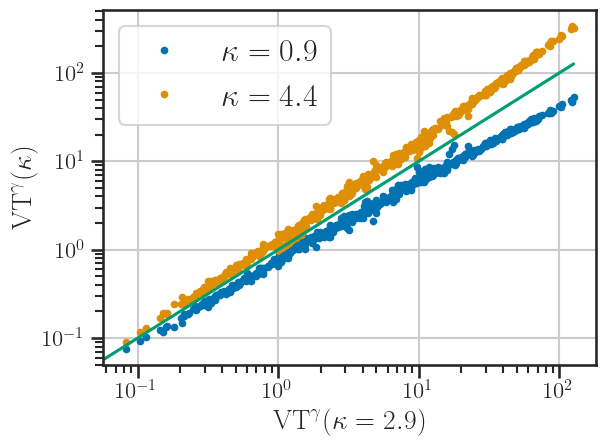

In [20]:
plt.loglog(vts,vts09,'.',label=r'$\kappa=0.9$',rasterized=True)
plt.loglog(vts,vts44,'.',label=r'$\kappa=4.4$',rasterized=True)
plt.loglog(vts[np.argsort(vts)],vts[np.argsort(vts)],rasterized=True)
plt.xlabel(r'$\rm{VT}^{\gamma}(\kappa=2.9)$', fontsize = 20)
plt.ylabel(r'$\rm{VT}^{\gamma}(\kappa)$',fontsize = 20)
plt.legend(fontsize=23)
plt.grid()
plt.tight_layout()
plt.savefig(plot_dir+'vts_vs_kappa.pdf')#,rasterized=True)

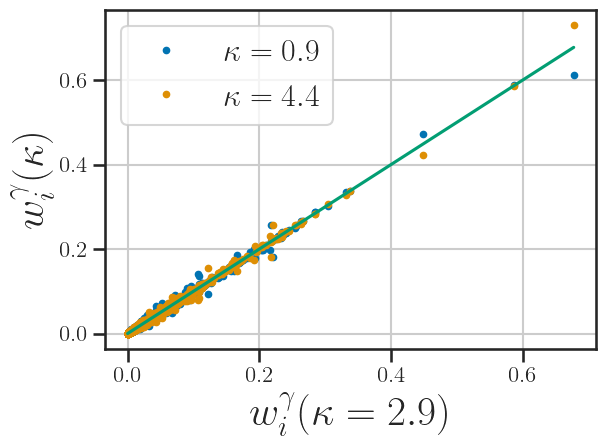

In [22]:
plt.plot(weights.flatten(),weights09.flatten(),'.',label=r'$\kappa=0.9$',rasterized=True)
plt.plot(weights.flatten(),weights44.flatten(),'.',label=r'$\kappa=4.4$',rasterized=True)
plt.plot(weights.flatten()[np.argsort(weights.flatten())],
         weights.flatten()[np.argsort(weights.flatten())],rasterized=True)
plt.xlabel(r'$w^{\gamma}_i(\kappa=2.9)$',fontsize = 30)
plt.ylabel(r'$w^{\gamma}_i(\kappa)$',fontsize = 30)
plt.legend(fontsize=23)
plt.grid()
plt.tight_layout()
plt.savefig(plot_dir+'weights_vs_kappa.pdf')

## GWTC-3 vary mbins and chi bins

In [ ]:
run_dir = 'test/gwtc3-clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins2.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new3.txt')
label = 'gwtc3_mbins2'
trace = az.from_netcdf('test/gwtc3-clean/gppop_posterior_newbins3_kappa_corr_mbins2_longer098.nc')

In [ ]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

In [ ]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [ ]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass1,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass1,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [ ]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,dm1,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass2,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass2,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [ ]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
ax.set_yscale('log')

ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [ ]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

In [ ]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])

ax.set_yscale('log')
ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

In [ ]:
run_dir = 'test/gwtc3-clean/'
plot_dir = 'plots/gwtc-3-prod/'
if not(os.path.exists(plot_dir)):
    os.makedirs(plot_dir)
mbins = np.loadtxt(run_dir+'mbins.txt')
chi_bins = np.loadtxt(run_dir+'chi_bins_new4.txt')
label = 'gwtc3_chibins4'
trace = az.from_netcdf('test/gwtc3-clean/gppop_posterior_newbins4_kappa_corr_mbins_longerr099.nc')

In [ ]:
N_samples = int(len(trace['posterior']['draw'])*len(trace['posterior']['chain']))
nbins_m = len(mbins)-1
nbins_m = int(0.5*nbins_m*(nbins_m+1))
nbins_chi = len(chi_bins)-1

n_corr_samples = np.array([trace['posterior']['n_corr'].to_numpy()[:,:,i].reshape((N_samples,)) for i in range(nbins_m*nbins_chi)]).T
n_corr_samples.shape

In [ ]:
utils = Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
dm1 = utils.delta_logm1s(mbins)
dm2 = utils.delta_logm2s(mbins)
log_bin_centers = utils.generate_log_bin_centers()
d_chis = utils.delta_chis()

In [ ]:
pp_utils = Post_Proc_Utils_spins(mbins,chi_bins,kappa=2.7)

In [ ]:
mass1,Rpm1_corr1 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass1,Rpm1_corr2 = pp_utils.get_Rpm1_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm1_corr1)/np.trapz(Rpm1_corr1,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass1,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm1_corr2)/np.trapz(Rpm1_corr2,mass1,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass1,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass1,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_1~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_1|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm1_chi_eff_{label}.pdf')
plt.show()

In [ ]:
mass2,Rpm2_corr1 = pp_utils.get_Rpm2_corr(n_corr_samples,dm1,d_chis,mbins,mbins,log_bin_centers,0.05,0.1)
mass2,Rpm2_corr2 = pp_utils.get_Rpm2_corr(n_corr_samples,dm2,d_chis,mbins,mbins,log_bin_centers,0.1,0.2)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})

Rp_m1=np.array(Rpm2_corr1)/np.trapz(Rpm2_corr1,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,label=r'$\chi_{eff} \in (0.05,0.1) $',color=colors[0])
ax.plot(mass2,R_pm_med,color=colors[0],linewidth=4.0)

Rp_m1=np.array(Rpm2_corr2)/np.trapz(Rpm2_corr2,mass2,axis=1)[:,None]
Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(mass2,Rpm_5,Rpm_95,alpha=0.3,color=colors[1],label=r'$\chi_{eff} \in (0.1,0.2)$')
ax.plot(mass2,R_pm_med,color=colors[1],linewidth=4.0)
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlim(5,110)
#ax.set_ylim(1e-3,1e1)

ax.set_xlabel(r'$m_2~\left[M_{\odot}\right]$',fontsize=fs)
ax.set_ylabel(r'$p(m_2|\chi_{eff})$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'm2_chi_eff_{label}.pdf')
plt.show()

In [ ]:
chi,Rp_chi_1 = pp_utils.get_Rpchi_m(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)
chi,Rp_chi_2 = pp_utils.get_Rpchi_m_complement(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,30,40)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m\in(30,40)$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$m \notin(30,40)$',color=colors[1])
ax.set_yscale('log')

ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|m_1,m_2)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=1,loc='upper left')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_m_{label}.pdf')
#plt.show()


In [ ]:
print(sorted(np.unique(log_bin_centers[:,1]/log_bin_centers[:,0]))[-2:])

In [ ]:
chi, Rp_chi_1 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.95,1)
chi, Rp_chi_2 = pp_utils.get_Rpchi_q(log_bin_centers,n_corr_samples,chi_bins,dm1,dm2,0.00001,0.95)

In [ ]:
fig, ax = plt.subplots(1,dpi = 500, tight_layout = True, figsize=(18*1.3,12*1.3))
matplotlib.rcParams.update({'font.size': 70})
Rp_m1=Rp_chi_1/np.trapz(Rp_chi_1,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q\approx 1$',color=colors[0])

Rp_m1=Rp_chi_2/np.trapz(Rp_chi_2,chi,axis=1)[:,None]

Rpm_5 = np.percentile(Rp_m1,q=5,axis=0)
Rpm_95 = np.percentile(Rp_m1,q=95,axis=0)
R_pm_med = np.percentile(Rp_m1,q=50,axis=0)
ax.fill_between(chi,Rpm_5,Rpm_95,alpha=0.3,label=r'$q<1$',color=colors[1])

ax.set_yscale('log')
ax.set_xlim(-0.3,0.4)
ax.set_ylim(1e-3,30)

ax.set_xlabel(r'$\chi_{eff}$',fontsize=fs)
ax.set_ylabel(r'$p(\chi_{eff}|q)$',fontsize=fs)
ax.tick_params(axis='both', which='major', labelsize=int(fs*0.8))
ax.tick_params(axis='both', which='minor', labelsize=int(fs*0.8))
ax.legend(fontsize=fs*0.58, framealpha=0.,ncol=2,loc='lower center')#,loc='lower right')
ax.xaxis.label.set_size(fs)
ax.yaxis.label.set_size(fs)
fig.tight_layout()
ax.grid(linestyle=':',linewidth=3)
fig.savefig(plot_dir+f'chi_eff_q_{label}.pdf')
#plt.show()

In [ ]:
trace41 = az.from_netcdf(run_dir+'gppop_posterior_newbins4_kappa_corr_mbins_longerr099.nc')
trace32 = az.from_netcdf(run_dir+'gppop_posterior_newbins3_kappa_corr_mbins2_longer098.nc')
trace31 = az.from_netcdf(run_dir+'gppop_posterior_newbins3_kappa_corr.nc')

In [ ]:
# trace['posterior'].keys()

In [ ]:
N_samples31 = int(len(trace31['posterior']['draw'])*len(trace31['posterior']['chain']))
N_samples32 = int(len(trace32['posterior']['draw'])*len(trace32['posterior']['chain']))
N_samples41 = int(len(trace41['posterior']['draw'])*len(trace41['posterior']['chain']))

In [ ]:
import gppop
gppop.__file__

## GP sanity checks

In [ ]:
_=plt.hist(trace31['posterior']['length_scale_m'].to_numpy().reshape((N_samples31,)),
           histtype='step',density=True,label='original',rasterized=True)
_=plt.hist(trace32['posterior']['length_scale_m'].to_numpy().reshape((N_samples32,)),
           histtype='step',density=True,label='new mass bins',rasterized=True)
_=plt.hist(trace41['posterior']['length_scale_m'].to_numpy().reshape((N_samples41,)),
           histtype='step',density=True,label='new spin bins',rasterized=True)
plt.legend()
plt.xlabel(r'$\lambda_{m}$',fontsize=25)
plt.tight_layout()
plt.savefig(plot_dir+'lambda_m_compare.pdf')

In [ ]:
nbins_hist=20
_=plt.hist(trace31['posterior']['length_scale_chi'].to_numpy().reshape((N_samples31,)),
           histtype='step',density=True,label='original',
          bins=nbins_hist,rasterized=True)
_=plt.hist(trace32['posterior']['length_scale_chi'].to_numpy().reshape((N_samples32,)),
           histtype='step',density=True,label='new mass bins',
          bins=nbins_hist,rasterized=True)
_=plt.hist(trace41['posterior']['length_scale_chi'].to_numpy().reshape((N_samples41,)),
           histtype='step',density=True,label='new spin bins',
          bins=nbins_hist,rasterized=True)
plt.legend()
plt.xlabel(r'$\lambda_{\chi}$',fontsize=25)
plt.tight_layout()
plt.savefig(plot_dir+'lambda_chi_compare.pdf')

In [ ]:
nbins_m = len(mbins)-1
n_chi_bins = len(chi_bins)-1
tril_indices = np.tril_indices(nbins_m)


In [ ]:
tril_indices

In [ ]:
weights = np.zeros((nbins_m,nbins_m,nbins_chi))

In [ ]:
for i in range(nbins_chi):
    weights[:,:,i]=i

In [ ]:
weights_tril = weights[tril_indices[0],tril_indices[1],:].T.flatten()

In [ ]:
weights_tril.shape,(nbins_m)*(nbins_m+1)*nbins_chi*0.5

In [ ]:
len(np.where(weights_tril<1)[0])